# Climate Risk Analysis: Wildfires & Floods in France & Spain

## Overview
This project analyzes the impact of **climate hazards (wildfires & floods)** in **France and Spain** to support **infrastructure resilience, risk assessment, and financial loss estimation**. The study is part of the **Eoliann Challenge**, aimed at enhancing climate risk modeling for **businesses, policymakers, and insurers**.


## Analysis Scope
We analyzed **two key climate hazards**:

###  **Wildfires (France & Spain)**
- **Regions Analyzed**:
  - **Spain**: Mediterranean regions with extreme fire events.
  - **France**: Southeastern areas like **Var and Provence-Alpes-Côte d'Azur**.
- **Key Findings**:
  - Forests and **semi-natural areas are the most impacted**.
  - **Infrastructure loss exceeded €5.6 billion**.
  - High rates of **"Completely Destroyed" and "Damaged" structures**.
  - Severe economic impact on **agriculture, transport, and energy**.

###  **Floods (France & Spain)**
- **Regions Analyzed**:  
  - **Northern France (Pas-de-Calais, Lille, Dunkirk)**.
- **Key Findings**:
  - **Estimated flooded area: 986.93 sq. km**.
  - Majority of flood cases reported **"No visible damage"**, possibly due to **underreporting or flood prevention measures**.
  - **Roads and transportation networks** were **highly impacted**.
  - Flood risk increases financial vulnerability for **older infrastructure**.

## Business Relevance
This analysis provides **key insights for businesses, policymakers, and insurers**:
 **Risk Assessment**: Identifies high-risk **assets & infrastructure**.  
 **Financial Loss Estimation**: Supports **insurance and investment decisions**.  
 **Resilience Planning**: Helps businesses develop **climate adaptation strategies**.  
 **Regulatory Compliance**: Assists companies in meeting **climate risk regulations**.  




# How to Run the Notebook  

## Prerequisites  
- **Google Drive is connected to Google Colab**  
- **The dataset is provided as a ZIP file**  

## Steps to Run the Notebook  

###  Unzip the Data File  
- Extract the contents of the ZIP file on your local machine. [BusinessC2]  

###  Upload the Files to Google Drive  
- Create a folder in your **Google Drive** (e.g., `Flood_Data`).  
- Upload all extracted files to this folder.  

###  Mount Google Drive in Colab  
In the first code cell of your Colab notebook, run:  
```python
from google.colab import drive
drive.mount('/content/drive/MyDrive/BusinessC2')


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# prompt: contextily install this

!pip install contextily


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 72.4 MB/s eta 0:00:00


#spain Fire

# Mapping Wildfire Impact in Castellón and Teruel

Wildfires leave a lasting mark on both landscapes and communities. This map visualizes the **extent of the damage**, showing how the fire spread across **roads, buildings, and natural areas** in Castellón and Teruel, Spain.

## What the Map Tells Us
- A **light red zone** marks the area affected by the fire.
- **Red dots** indicate buildings that were damaged or destroyed.
- **Pink lines** trace transportation routes that may have been impacted.
- **Blue lines** represent rivers and water sources, crucial for firefighting and recovery.

## How It Works
This visualization is built using **GeoPandas** and **Matplotlib**:
1. **Fire-affected zones and infrastructure layers** are loaded from geospatial data.
2. Everything is projected onto a **consistent coordinate system** (EPSG:3857) to align with a basemap.
3. Colors and transparency are carefully chosen to **highlight damage without obscuring details**.
4. A **CartoDB basemap** provides geographic context, making it easy to relate fire damage to real-world locations.

## Why This Matters
This map helps responders, policymakers, and researchers:
- Identify **high-damage areas** for targeted recovery efforts.
- Assess how **transportation routes** were affected.
- Plan for **future wildfire prevention and response**.

A wildfire’s impact is more than just burned land—it's lost homes, disrupted communities, and a changed landscape. This map brings those effects into focus.


In [31]:
import geopandas as gpd
import folium
import os

# 📂 Set the folder path containing the shapefiles
folder_path = "/content/drive/MyDrive/BusinessC2/Data/Spain/Spain Fire/Castellon and Teruel Region/EMSR656_AOI01_BLP/"

# 🎨 Define category-specific colors
color_settings = {
    'Burnt Area': {'color': 'red'},
    'Burnt Buildings': {'color': 'darkred'},
    'Built Up Area': {'color': 'orange'},
    'Transportation Line': {'color': 'purple'},
    'Water Sources': {'color': 'blue'}
}

# 🔍 Categorized shapefiles
shapefile_categories = {
    # 'EMSR656_AOI01_BLP_PRODUCT_areaOfInterestA_v1.shp': 'Burnt Area',
    'EMSR656_AOI01_BLP_PRODUCT_builtUpP_v1.shp': 'Burnt Buildings',
  #  / 'EMSR656_AOI01_BLP_PRODUCT_builtUpA_v1.shp': 'Built Up Area',
    'EMSR656_AOI01_BLP_PRODUCT_transportationL_v1.shp': 'Transportation Line',
    'EMSR656_AOI01_BLP_PRODUCT_hydrographyL_v1.shp': 'Water Sources'
}

# 🔍 Initialize an interactive map centered on Castellón and Teruel
m = folium.Map(location=[39.97, -0.53], zoom_start=12, tiles="OpenStreetMap")

# 📍 Add each shapefile layer
for shp_filename, category in shapefile_categories.items():
    shp_path = os.path.join(folder_path, shp_filename)

    # ✅ Check if file exists before loading
    if not os.path.exists(shp_path):
        print(f"⚠️ Skipping {shp_filename}: File not found.")
        continue

    try:
        gdf = gpd.read_file(shp_path)  # Load shapefile

        # 🔄 Convert CRS to EPSG:4326 for Folium compatibility
        if gdf.crs and gdf.crs != 'EPSG:4326':
            gdf = gdf.to_crs(epsg=4326)

        # 📌 Define a FeatureGroup for better layer control
        layer = folium.FeatureGroup(name=category)

        # 📍 Handle different geometries
        for _, row in gdf.iterrows():
            if row.geometry.geom_type == 'Point':
                folium.CircleMarker(
                    location=[row.geometry.y, row.geometry.x],
                    radius=5,
                    color=color_settings[category]['color'],
                    fill=True,
                    fill_color=color_settings[category]['color'],
                    popup=f"{category}: {row.get('name', 'Unknown')}"
                ).add_to(layer)
            elif row.geometry.geom_type in ['LineString', 'MultiLineString']:
                folium.GeoJson(
                    row.geometry,
                    name=category,
                    style_function=lambda x, color=color_settings[category]['color']: {'color': color, 'weight': 2}
                ).add_to(layer)
            elif row.geometry.geom_type in ['Polygon', 'MultiPolygon']:
                folium.GeoJson(
                    row.geometry,
                    name=category,
                    style_function=lambda x, color=color_settings[category]['color']: {'color': color, 'weight': 1, 'fillOpacity': 0.4}
                ).add_to(layer)

        # 🗺️ Add the layer to the map
        layer.add_to(m)

    except Exception as e:
        print(f"⚠️ Error loading {shp_filename}: {e}")

# 🔘 Add Layer Control for toggling layers
folium.LayerControl().add_to(m)

# ✅ Save and display the map
# m.save("Wildfire_Impact_Map.html")
m


# 🔥 Interactive Wildfire Impact Map – Tenerife Region

## 📌 Overview
This interactive map visualizes wildfire damage, infrastructure, roads, and natural land use in Tenerife. Users can zoom, pan, and toggle layers to explore the fire's impact.

## 🗺️ Map Layers
- **🔥 Burnt Areas (Red):** Fire-damaged zones.
- **🏠 Burnt Buildings (Dark Red):** Affected structures.
- **🏗️ Damaged Facilities (Blue):** Impacted infrastructure.
- **🚗 Damaged Roads (Orange):** Affected transportation networks.
- **⚡ Electricity & Pipelines (Purple):** Utility infrastructure.
- **🌿 Natural Land Use (Green):** Vegetation and land cover.
- **💧 Water Bodies (Blue):** Streams and reservoirs.
- **🖤 Fire Perimeter (Black):** Outline of the wildfire-affected area.

## 🔹 Features
- **Interactive & Zoomable** for better analysis.
- **Layer Control Toggle** to explore specific data.
- **Clickable Markers & Polygons** for detailed insights.

This map helps assess **wildfire damage** and supports recovery efforts.


In [11]:
import geopandas as gpd
import folium
import os
from folium.plugins import MarkerCluster

# 📂 Set the folder path containing the shapefiles
folder_path = "/content/drive/MyDrive/BusinessC2/Data/Spain/Spain Fire/Tenerife/EMSR685_AOI01_GRA_PRODUCT_v1/"

# 🔍 Categorized shapefiles (Make sure they exist before using them)
shapefile_categories = {
    'EMSR685_AOI01_GRA_PRODUCT_observedEventA_v1.shp': {'name': 'Burnt Areas', 'color': 'red'},
    'EMSR685_AOI01_GRA_PRODUCT_builtUpP_v1.shp': {'name': 'Burnt Buildings', 'color': 'darkred'},
    'EMSR685_AOI01_GRA_PRODUCT_facilitiesA_v1.shp': {'name': 'Damaged Facilities', 'color': 'blue'},
    'EMSR685_AOI01_GRA_PRODUCT_transportationL_v1.shp': {'name': 'Damaged Roads', 'color': 'orange'},
    'EMSR685_AOI01_GRA_PRODUCT_facilitiesL_v1.shp': {'name': 'Electricity & Pipelines', 'color': 'purple'},
    # 'EMSR685_AOI01_GRA_PRODUCT_naturalLandUseA_v1.shp': {'name': 'Natural Land Use', 'color': 'green'},
    'EMSR685_AOI01_GRA_PRODUCT_hydrographyL_v1.shp': {'name': 'Water Bodies', 'color': 'blue'}
    # ,
    # 'EMSR685_AOI01_GRA_PRODUCT_areaOfInterestA_v1.shp': {'name': 'Fire Perimeter', 'color': 'black'}
}

# 🔍 Initialize an empty map (Zoomed to the approximate fire location)
m = folium.Map(location=[28.41, -16.5], zoom_start=12, tiles="OpenStreetMap")

# 📍 Add layers to the map
for shp_filename, category in shapefile_categories.items():
    shp_path = os.path.join(folder_path, shp_filename)

    # ✅ Check if the file exists before attempting to load
    if not os.path.exists(shp_path):
        print(f"⚠️ Skipping {shp_filename}: File not found.")
        continue

    try:
        gdf = gpd.read_file(shp_path)  # Load shapefile

        # 🔄 Reproject to EPSG:4326 (Lat, Lon) for compatibility with Folium
        if gdf.crs and gdf.crs != 'EPSG:4326':
            gdf = gdf.to_crs(epsg=4326)

        # 📌 Define layer group
        layer = folium.FeatureGroup(name=category['name'])

        # 📍 Handle different geometries
        for _, row in gdf.iterrows():
            if row.geometry.geom_type == 'Point':
                folium.Marker(
                    location=[row.geometry.y, row.geometry.x],
                    popup=f"{category['name']}",
                    icon=folium.Icon(color=category['color'], icon="info-sign")
                ).add_to(layer)
            elif row.geometry.geom_type in ['LineString', 'MultiLineString']:
                folium.GeoJson(
                    row.geometry,
                    name=category['name'],
                    style_function=lambda x, color=category['color']: {'color': color, 'weight': 3}
                ).add_to(layer)
            elif row.geometry.geom_type in ['Polygon', 'MultiPolygon']:
                folium.GeoJson(
                    row.geometry,
                    name=category['name'],
                    style_function=lambda x, color=category['color']: {'color': color, 'weight': 1, 'fillOpacity': 0.4}
                ).add_to(layer)

        # 🗺️ Add the layer to the map
        layer.add_to(m)

    except Exception as e:
        print(f"⚠️ Error loading {shp_filename}: {e}")

# 🔘 Add Layer Control for toggling layers
folium.LayerControl().add_to(m)

# ✅ Save map as HTML file & display
m.save("Wildfire_Impact_Map.html")
m


⚠️ Skipping EMSR685_AOI01_GRA_PRODUCT_transportationL_v1.shp: File not found.
⚠️ Skipping EMSR685_AOI01_GRA_PRODUCT_hydrographyL_v1.shp: File not found.


# 🔥 Interactive Wildfire Impact Map – Valancia Region

## 📌 Overview
This interactive map visualizes wildfire damage, infrastructure, roads, and water bodies in the Valancia region. It allows zooming, panning, and toggling different layers to analyze fire impact.

## 🗺️ Map Layers
- **🔥 Fire Perimeter (Red):** Burnt area boundary.
- **🏠 Burnt Buildings (Dark Red):** Structures affected by fire.
- **💧 Water Bodies (Blue):** Rivers and reservoirs.
- **🌿 Burnt Vegetation (Green):** Damaged natural areas.
- **🚗 Transportation Network (Orange):** Roads and highways.
- **🏗️ Infrastructure (Purple):** Critical facilities.

## 🔹 Features
- **Interactive & Zoomable** for detailed analysis.
- **Layer Toggle Control** to focus on specific elements.
- **Clickable Markers & Polygons** for additional insights.

This map helps in assessing **wildfire damage**, aiding recovery and planning efforts.


In [12]:
import geopandas as gpd
import folium
import os

# 📂 Set the folder path containing the shapefiles
folder_path = "/content/drive/MyDrive/BusinessC2/Data/Spain/Spain Fire/Valancia Region/"

# 🎨 Define category-specific colors
color_settings = {
    'Fire Perimeter': 'red',
    'Burnt Buildings': 'darkred',
    'Water Bodies': 'blue',
    'Burnt Vegetation': 'green',
    'Transportation Network': 'orange',
    'Infrastructure': 'purple'
}

# 🔍 Categorized shapefiles
shapefile_categories = {
    # 'EMSR704_AOI01_BLP_PRODUCT_areaOfInterestA_v1.shp': 'Fire Perimeter',
    'EMSR704_AOI01_BLP_PRODUCT_builtUpP_v1.shp': 'Burnt Buildings',
    'EMSR704_AOI01_BLP_PRODUCT_hydrographyA_v1.shp': 'Water Bodies',
    # 'EMSR704_AOI01_BLP_PRODUCT_naturalLandUseA_v1.shp': 'Burnt Vegetation',
    'EMSR704_AOI01_BLP_PRODUCT_transportationL_v1.shp': 'Transportation Network',
    'EMSR704_AOI01_BLP_PRODUCT_facilitiesA_v1.shp': 'Infrastructure'
}

# 🔍 Initialize an interactive map centered on Valancia Region
m = folium.Map(location=[38.9, -0.3], zoom_start=14, tiles="OpenStreetMap")

# 📍 Add each shapefile layer
for shp_filename, category in shapefile_categories.items():
    shp_path = os.path.join(folder_path, shp_filename)

    # ✅ Check if file exists before loading
    if not os.path.exists(shp_path):
        print(f"⚠️ Skipping {shp_filename}: File not found.")
        continue

    try:
        gdf = gpd.read_file(shp_path)  # Load shapefile

        # 🔄 Convert CRS to EPSG:4326 for Folium compatibility
        if gdf.crs and gdf.crs != 'EPSG:4326':
            gdf = gdf.to_crs(epsg=4326)

        # 📌 Define a FeatureGroup for layer control
        layer = folium.FeatureGroup(name=category)

        # 📍 Handle different geometries
        for _, row in gdf.iterrows():
            if row.geometry.geom_type == 'Point':
                folium.CircleMarker(
                    location=[row.geometry.y, row.geometry.x],
                    radius=5,
                    color=color_settings[category],
                    fill=True,
                    fill_color=color_settings[category],
                    popup=f"{category}"
                ).add_to(layer)
            elif row.geometry.geom_type in ['LineString', 'MultiLineString']:
                folium.GeoJson(
                    row.geometry,
                    name=category,
                    style_function=lambda x, color=color_settings[category]: {'color': color, 'weight': 2}
                ).add_to(layer)
            elif row.geometry.geom_type in ['Polygon', 'MultiPolygon']:
                folium.GeoJson(
                    row.geometry,
                    name=category,
                    style_function=lambda x, color=color_settings[category]: {'color': color, 'weight': 1, 'fillOpacity': 0.4}
                ).add_to(layer)

        # 🗺️ Add the layer to the map
        layer.add_to(m)

    except Exception as e:
        print(f"⚠️ Error loading {shp_filename}: {e}")

# 🔘 Add Layer Control for toggling layers
folium.LayerControl().add_to(m)

# ✅ Display the interactive map
m


#Spain Floods

# 🌊 Flood Impact Map: Calalberche, Spain

## 🗺️ Overview
This interactive map visualizes the **flood impact** in Calalberche, Spain. It highlights affected areas, damaged infrastructure, and flood traces using multiple geospatial layers.

## 📌 Key Insights
- **Flooded Areas (Blue):** Shows the extent of flood traces detected in the region.
- **Damaged Buildings (Dark Red):** Points represent possibly damaged structures due to flooding.
- **Damaged Roads & Bridges (Orange):** Roads and bridges that have been affected or destroyed.
- **Bridge Collapse Points (Red Markers):** Indicates locations where bridges have either collapsed or sustained severe damage.
- **Affected Zone (Black Overlay):** Defines the area most impacted by the flood event.

## 🔎 Analysis
- The **flooded areas** align closely with river pathways, indicating riverine flooding.
- Several **bridges have collapsed**, disrupting transportation in the region.
- **Critical infrastructure**, including roads and buildings, has suffered extensive damage.
- The **extent of the affected zone** suggests a significant impact on the local population and economy.

## 🚀 Interactive Features
- **Layer Control:** Toggle different layers to focus on specific aspects of the flood impact.
- **Zoom & Pan:** Explore the affected region in detail.
- **Popups:** Click on markers to get more details about damaged structures.

This visualization provides a **clear, data-driven view** of the flood’s impact, aiding in disaster response and recovery planning.


In [13]:
import geopandas as gpd
import folium
import os

# 📂 Set the folder path containing the flood-related shapefiles
folder_path = "/content/drive/MyDrive/BusinessC2/Data/Spain/Spain Flood/Calaberche/"

# 🔍 Categorized shapefiles (Excluding Satellite Image Coverage)
shapefile_categories = {
    'EMSR694_AOI02_GRA_PRODUCT_observedEventA_v1.shp': {'name': 'Flooded Areas', 'color': 'blue'},
    'EMSR694_AOI02_GRA_PRODUCT_builtUpP_v1.shp': {'name': 'Damaged Buildings', 'color': 'darkred'},
    'EMSR694_AOI02_GRA_PRODUCT_transportationL_v1.shp': {'name': 'Damaged Roads & Bridges', 'color': 'orange'},
    'EMSR694_AOI02_GRA_PRODUCT_transportationP_v1.shp': {'name': 'Bridge Collapse Points', 'color': 'red'},
    'EMSR694_AOI02_GRA_PRODUCT_areaOfInterestA_v1.shp': {'name': 'Affected Zone', 'color': 'black'}
}

# 🔍 Initialize the interactive map centered around the affected area
m = folium.Map(location=[40.30, -4.15], zoom_start=12, tiles="OpenStreetMap")

# 📍 Add each shapefile as a separate layer (Excluding Satellite Coverage)
for shp_filename, category in shapefile_categories.items():
    shp_path = os.path.join(folder_path, shp_filename)

    # ✅ Check if the file exists before loading
    if not os.path.exists(shp_path):
        print(f"⚠️ Skipping {shp_filename}: File not found.")
        continue

    try:
        gdf = gpd.read_file(shp_path)  # Load shapefile

        # 🔄 Convert CRS to EPSG:4326 (Latitude/Longitude) for Folium
        if gdf.crs and gdf.crs != 'EPSG:4326':
            gdf = gdf.to_crs(epsg=4326)

        # 📌 Define a FeatureGroup for each category
        layer = folium.FeatureGroup(name=category['name'])

        # 🗺️ Handle different geometries
        for _, row in gdf.iterrows():
            if row.geometry.geom_type == 'Point':
                folium.Marker(
                    location=[row.geometry.y, row.geometry.x],
                    popup=f"{category['name']}",
                    icon=folium.Icon(color=category['color'], icon="info-sign")
                ).add_to(layer)
            elif row.geometry.geom_type in ['LineString', 'MultiLineString']:
                folium.GeoJson(
                    row.geometry,
                    name=category['name'],
                    style_function=lambda x, color=category['color']: {'color': color, 'weight': 2}
                ).add_to(layer)
            elif row.geometry.geom_type in ['Polygon', 'MultiPolygon']:
                folium.GeoJson(
                    row.geometry,
                    name=category['name'],
                    style_function=lambda x, color=category['color']: {'color': color, 'weight': 1, 'fillOpacity': 0.4}
                ).add_to(layer)

        # 🏷️ Add the layer to the map
        layer.add_to(m)

    except Exception as e:
        print(f"⚠️ Error loading {shp_filename}: {e}")

# 🔘 Add layer control (Without Satellite Image Coverage)
folium.LayerControl().add_to(m)

# ✅ Display the interactive map
m


#Spain analysis

-	Take the shared wildfire dataset (1) as an example: with some processing, you can extract the same 'obj_type' and 'damage_gra' information from “grading” data available among Rapid Mapping Activations (2). Which types of infrastructure assets are impacted the most and the least by flood, storm and wildfire hazards?

<ipython-input-14-4edf80a9e1d6>:7: DtypeWarning: Columns (7,8,9,10,11,12,13,14) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


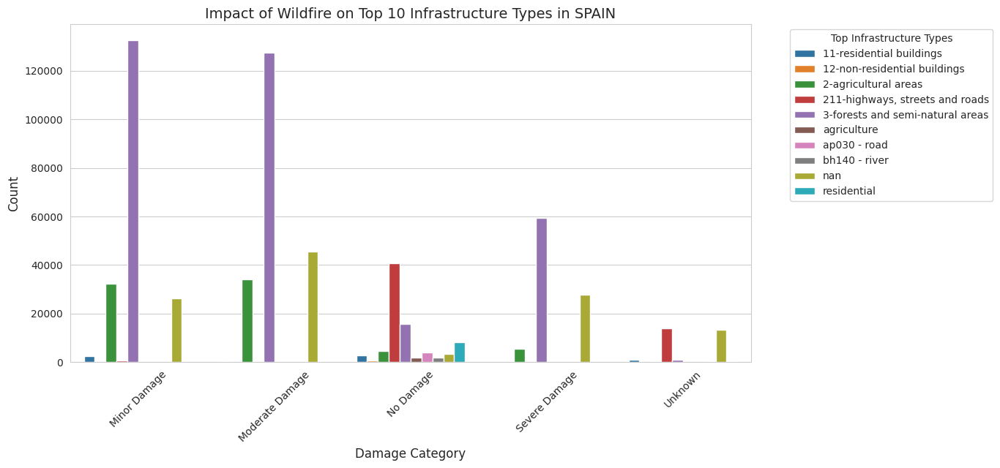

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = "/content/drive/MyDrive/BusinessC2/df_spain.csv"  # Update the file path if needed
df = pd.read_csv(file_path)

# Extract and clean 'obj_type' and 'damage_gra' from the dataset
wildfire_data = df[['obj_type', 'damage_gra']].copy()

# Standardizing text
wildfire_data['obj_type'] = wildfire_data['obj_type'].astype(str).str.strip().str.lower()
wildfire_data['damage_gra'] = wildfire_data['damage_gra'].astype(str).str.strip().str.lower()

# Handling missing values
wildfire_data.fillna('unknown', inplace=True)

# Standardizing damage grading categories
damage_mapping = {
    'destroyed': 'Severe Damage',
    'completely destroyed': 'Severe Damage',
    'damaged': 'Moderate Damage',
    'moderately damaged': 'Moderate Damage',
    'possibly damaged': 'Minor Damage',
    'possibly affected': 'Minor Damage',
    'no visible damage': 'No Damage',
    'not affected': 'No Damage',
    'negligible to slight damage': 'Minor Damage',
    'highly damaged': 'Severe Damage',
    'moderate damage': 'Moderate Damage',
    'very high damage': 'Severe Damage',
    'high damage': 'Severe Damage',
}

# Apply the mapping
wildfire_data['damage_category'] = wildfire_data['damage_gra'].map(damage_mapping).fillna('Unknown')

# Filter top 10 most affected infrastructure types
top_obj_types = wildfire_data['obj_type'].value_counts().nlargest(10).index
wildfire_data_filtered = wildfire_data[wildfire_data['obj_type'].isin(top_obj_types)]

# Set plot style
sns.set_style("whitegrid")

# Create a plot for top affected infrastructure types
plt.figure(figsize=(12, 6))
damage_counts = wildfire_data_filtered.groupby(['obj_type', 'damage_category']).size().reset_index(name='count')
sns.barplot(data=damage_counts, x='damage_category', y='count', hue='obj_type')

# Formatting the plot
plt.title("Impact of Wildfire on Top 10 Infrastructure Types in SPAIN", fontsize=14)
plt.xlabel("Damage Category", fontsize=12)
plt.ylabel("Count", fontsize=12)
plt.xticks(rotation=45)

# Adjust legend - only showing top 10 categories
plt.legend(title="Top Infrastructure Types", bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.show()


<ipython-input-15-aaeb2974e092>:7: DtypeWarning: Columns (7,8,9,10,11,12,13,14) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)
<ipython-input-15-aaeb2974e092>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_europe['damage_category'] = df_europe['damage_gra'].map(damage_mapping).fillna('Unknown')


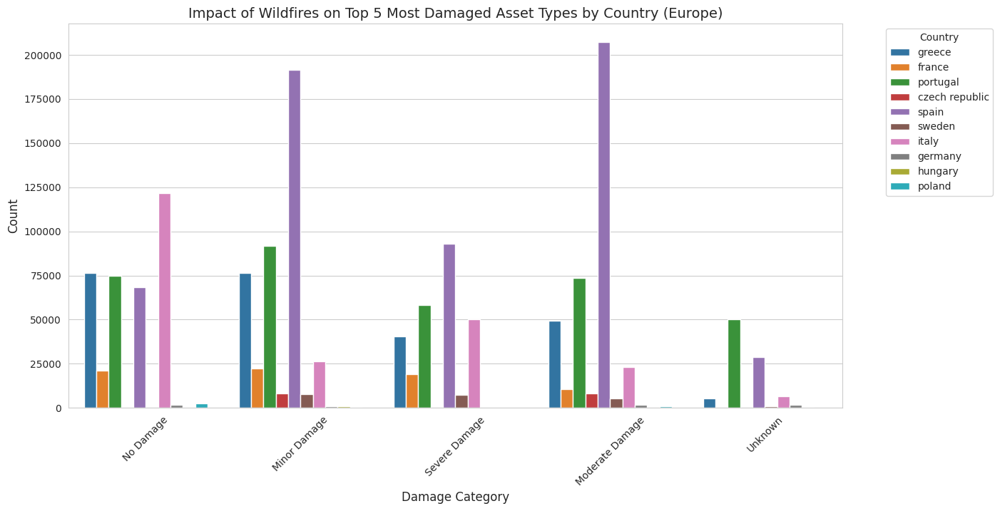

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = "/content/drive/MyDrive/BusinessC2/emsr_wildfire_damage_data/emsr_wildfire_damage_data.csv"  # Update with your actual file path
df = pd.read_csv(file_path)

# Convert event_time to datetime format
df['event_time'] = pd.to_datetime(df['event_time'], errors='coerce')

# Standardizing text for 'obj_type', 'damage_gra', and 'country'
df['obj_type'] = df['obj_type'].astype(str).str.strip().str.lower()
df['damage_gra'] = df['damage_gra'].astype(str).str.strip().str.lower()
df['country'] = df['country'].astype(str).str.strip().str.lower()

# Define a list of European countries
european_countries = [
    "spain", "france", "germany", "italy", "portugal", "netherlands", "belgium", "sweden",
    "norway", "finland", "denmark", "switzerland", "austria", "ireland", "uk", "greece",
    "poland", "czech republic", "hungary"
]

# Filter only European countries
df_europe = df[df['country'].isin(european_countries)]

# Standardizing damage grading categories
damage_mapping = {
    'destroyed': 'Severe Damage',
    'completely destroyed': 'Severe Damage',
    'damaged': 'Moderate Damage',
    'moderately damaged': 'Moderate Damage',
    'possibly damaged': 'Minor Damage',
    'possibly affected': 'Minor Damage',
    'no visible damage': 'No Damage',
    'not affected': 'No Damage',
    'negligible to slight damage': 'Minor Damage',
    'highly damaged': 'Severe Damage',
    'moderate damage': 'Moderate Damage',
    'very high damage': 'Severe Damage',
    'high damage': 'Severe Damage',
}

# Apply the mapping
df_europe['damage_category'] = df_europe['damage_gra'].map(damage_mapping).fillna('Unknown')

# Identify the top 5 most frequently damaged asset types
top_5_assets = df_europe['obj_type'].value_counts().nlargest(5).index
df_filtered = df_europe[df_europe['obj_type'].isin(top_5_assets)]

# Set plot style
sns.set_style("whitegrid")

# Create a grouped bar plot showing damage distribution by country for top 5 asset types
plt.figure(figsize=(14, 7))
sns.countplot(data=df_filtered, x='damage_category', hue='country')

# Formatting the plot
plt.title("Impact of Wildfires on Top 5 Most Damaged Asset Types by Country (Europe)", fontsize=14)
plt.xlabel("Damage Category", fontsize=12)
plt.ylabel("Count", fontsize=12)
plt.xticks(rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.show()


<ipython-input-16-a01aa37f3bdb>:7: DtypeWarning: Columns (7,8,9,10,11,12,13,14) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


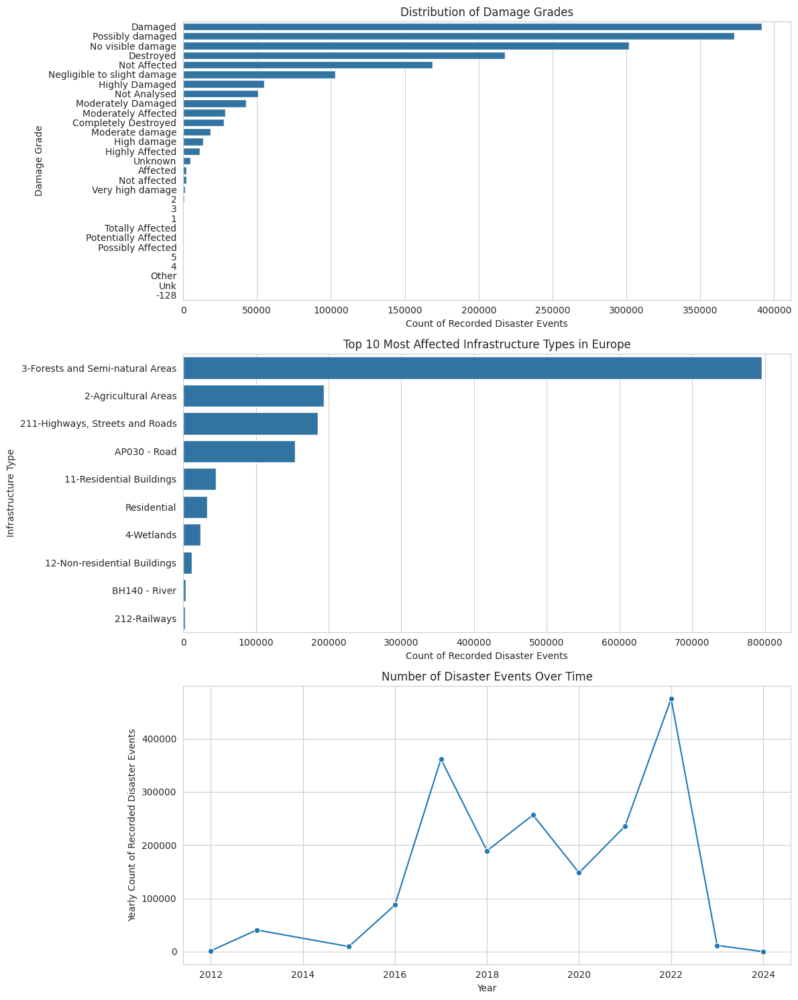

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = "/content/drive/MyDrive/BusinessC2/emsr_wildfire_damage_data/emsr_wildfire_damage_data.csv"  # Update this path if needed
df = pd.read_csv(file_path)

# Convert event_time to datetime format
df['event_time'] = pd.to_datetime(df['event_time'], ='coerce')

# Set plot style
sns.set_style("whitegrid")

# Create a figure with subplots (3 rows, 1 column)
fig, axes = plt.subplots(3, 1, figsize=(12, 15))

# 1. Damage grade distribution
sns.countplot(y=df['damage_gra'], order=df['damage_gra'].value_counts().index, ax=axes[0])
axes[0].set_title("Distribution of Damage Grades")
axes[0].set_xlabel("Count of Recorded Disaster Events")
axes[0].set_ylabel("Damage Grade")

# 2. Infrastructure types affected
top_obj_types = df['obj_type'].value_counts().nlargest(10)  # Top 10 most affected types
sns.barplot(y=top_obj_types.index, x=top_obj_types.values, ax=axes[1])
axes[1].set_title("Top 10 Most Affected Infrastructure Types in Europe")
axes[1].set_xlabel("Count of Recorded Disaster Events")
axes[1].set_ylabel("Infrastructure Type")

# 3. Trend of disaster events over time
df['year'] = df['event_time'].dt.year
yearly_counts = df['year'].value_counts().sort_index()
sns.lineplot(x=yearly_counts.index, y=yearly_counts.values, marker='o', ax=axes[2])
axes[2].set_title("Number of Disaster Events Over Time")
axes[2].set_xlabel("Year")
axes[2].set_ylabel("Yearly Count of Recorded Disaster Events")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()


#France Data Analysys

# Wildfire Impact Analysis - Affected Areas and Burnt Land

## Overview
This interactive map visualizes the **impact of a wildfire** in the **Gonfaron region, France**. It highlights different land-use types affected by the fire and provides an estimate of the **total burnt area (6977.35 sq. km)**.

## Key Elements in the Map
- **🔥 Wildfire Areas (Orange/Red):** Burnt regions with varying intensity.  
- **🏠 Built-Up Areas (Red):** Residential and infrastructure damage.  
- **🏢 Facilities (Blue):** Key infrastructure affected.  
- **🌿 Natural Land Use (Green):** Forests and vegetation impacted.  
- **🛣️ Transportation Networks (Purple):** Roads and highways at risk.  

## Business Usefulness for the Company
- **📊 Risk Assessment:** Helps **infrastructure companies** evaluate damage to assets.  
- **🌍 Environmental Impact:** Provides insights into **forest loss and ecological damage**.  
- **🛠️ Recovery Planning:** Guides resource allocation for **rebuilding and mitigation** efforts.  
- **📈 Insurance & Financial Risk:** Supports **insurance claims and future risk modeling**.  

This analysis enables **better decision-making for disaster response, resilience planning, and financial risk assessment**.


In [17]:
import os
import geopandas as gpd
import folium
from folium.plugins import Fullscreen
from IPython.display import display

# Define the folder containing the .shp files
folder_path = "/content/drive/MyDrive/BusinessC2/Data/France/France Fire/France Fire/Gonfaron/"  # Update this path

# List of relevant shapefiles
shapefiles = {
    "Built-Up Areas": "EMSR541_AOI01_GRA_PRODUCT_builtUpA_r1_v1.shp",
    "Facilities": "EMSR541_AOI01_GRA_PRODUCT_facilitiesA_r1_v1.shp",
    "Observed Wildfire Areas": "EMSR541_AOI01_GRA_PRODUCT_observedEventA_r1_v1.shp",
    # "Natural Land Use": "EMSR541_AOI01_GRA_PRODUCT_naturalLandUseA_r1_v1.shp",
    "Transportation Networks": "EMSR541_AOI01_GRA_PRODUCT_transportationL_r1_v1.shp"
}

# Define colors for different categories
layer_colors = {
    "Built-Up Areas": "red",
    "Facilities": "blue",
    "Observed Wildfire Areas": "orange",
    "Natural Land Use": "green",
    "Transportation Networks": "purple"
}

# Initialize an interactive Folium map
base_map = folium.Map(location=[43.35, 6.35], zoom_start=12)

# Load and add each shapefile to the map
for layer_name, shp_file in shapefiles.items():
    shp_path = os.path.join(folder_path, shp_file)

    try:
        # Load the shapefile into a GeoDataFrame
        gdf = gpd.read_file(shp_path)

        # Extract color based on layer
        color = layer_colors.get(layer_name, "gray")

        # Convert GeoDataFrame to JSON and add to the map
        folium.GeoJson(
            gdf,
            name=layer_name,
            style_function=lambda feature, color=color: {
                "color": color,
                "weight": 2,
                "fillOpacity": 0.5,
            },
            tooltip=folium.GeoJsonTooltip(
                fields=[col for col in gdf.columns if col not in ['geometry']][:3],  # First 3 columns as tooltip
                aliases=[col for col in gdf.columns if col not in ['geometry']][:3]
            )
        ).add_to(base_map)

    except Exception as e:
        print(f"Error loading {shp_file}: {e}")

# Extract Burnt Area Information from Observed Wildfire Layer
burnt_area_file = shapefiles["Observed Wildfire Areas"]
burnt_area_path = os.path.join(folder_path, burnt_area_file)

try:
    burnt_gdf = gpd.read_file(burnt_area_path)
    total_burnt_area = burnt_gdf["area"].sum()  # Sum of burnt areas
    burnt_area_text = f"Total Burnt Area: {total_burnt_area:.2f} sq. km"
except Exception as e:
    print(f"Error extracting burnt area: {e}")
    burnt_area_text = "Burnt Area Data Not Available"

# Add a legend manually using an HTML overlay
legend_html = f"""
<div style="position: fixed;
            bottom: 40px; left: 40px; width: 250px; height: auto;
            background-color: white; z-index:9999; font-size:14px;
            border-radius:5px; padding: 10px;
            box-shadow: 2px 2px 5px rgba(0,0,0,0.3);">
    <b>Legend</b><br>
    <i class="fa fa-map-marker fa-2x" style="color:{layer_colors['Built-Up Areas']}"></i> Built-Up Areas<br>
    <i class="fa fa-map-marker fa-2x" style="color:{layer_colors['Facilities']}"></i> Facilities<br>
    <i class="fa fa-map-marker fa-2x" style="color:{layer_colors['Observed Wildfire Areas']}"></i> Wildfire Areas<br>
    <i class="fa fa-map-marker fa-2x" style="color:{layer_colors['Natural Land Use']}"></i> Natural Land Use<br>
    <i class="fa fa-map-marker fa-2x" style="color:{layer_colors['Transportation Networks']}"></i> Transportation Networks<br>
    <hr>
    <b>{burnt_area_text}</b>
</div>
"""

base_map.get_root().html.add_child(folium.Element(legend_html))

# Add full-screen support
Fullscreen(position="topright").add_to(base_map)

# Add a layer control to toggle different layers
folium.LayerControl().add_to(base_map)

# Display the interactive map inside Jupyter Notebook
display(base_map)


In [18]:
import pandas as pd

# Define the correct file path (file is in Colab's root directory)
file_path = "/content/drive/MyDrive/BusinessC2/df_france.csv"

# Load dataset
df = pd.read_csv(file_path)

# Display dataset structure and first few rows
df.info()
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74636 entries, 0 to 74635
Data columns (total 22 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   fid         74636 non-null  int64  
 1   obj_type    48869 non-null  object 
 2   info        64008 non-null  object 
 3   damage_gra  74636 non-null  object 
 4   event_time  74636 non-null  object 
 5   country     74636 non-null  object 
 6   filename    74636 non-null  object 
 7   txt         10628 non-null  object 
 8   act_id      10628 non-null  object 
 9   interpret   10220 non-null  object 
 10  settl_type  10220 non-null  object 
 11  subtype     10628 non-null  object 
 12  functional  408 non-null    object 
 13  road_type   0 non-null      float64
 14  simplified  0 non-null      float64
 15  objectid    0 non-null      float64
 16  length      74636 non-null  float64
 17  area        74636 non-null  float64
 18  area_ha     74636 non-null  float64
 19  emsr_id     74636 non-nul

<ipython-input-18-dbe65b67941e>:7: DtypeWarning: Columns (7,8,9,10,11,12) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


,fid,obj_type,info,damage_gra,event_time,country,filename,txt,act_id,interpret,...,functional,road_type,simplified,objectid,length,area,area_ha,emsr_id,fwi,wui_label
0,2747,"215-Harbours, waterways, dams and other waterw...",21513-Breakwater,No visible damage,2022-07-12,France,EMSR592_AOI02_GRA_PRODUCT_facilitiesL_r1_v1.shx,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,34.299029,0.0,0.0,592,19.613281,nodata
1,2748,"215-Harbours, waterways, dams and other waterw...",21514-Navigable canals,No visible damage,2022-07-12,France,EMSR592_AOI02_GRA_PRODUCT_facilitiesL_r1_v1.shx,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,5359.032367,0.0,0.0,592,19.613281,nodata
2,2749,"215-Harbours, waterways, dams and other waterw...",21514-Navigable canals,No visible damage,2022-07-12,France,EMSR592_AOI02_GRA_PRODUCT_facilitiesL_r1_v1.shx,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,308.858885,0.0,0.0,592,30.324219,nodata
3,2750,"215-Harbours, waterways, dams and other waterw...",21514-Navigable canals,No visible damage,2022-07-12,France,EMSR592_AOI02_GRA_PRODUCT_facilitiesL_r1_v1.shx,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,3.878224,0.0,0.0,592,30.324219,nodata
4,2751,"215-Harbours, waterways, dams and other waterw...",21514-Navigable canals,No visible damage,2022-07-12,France,EMSR592_AOI02_GRA_PRODUCT_facilitiesL_r1_v1.shx,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,9.041898,0.0,0.0,592,30.324219,nodata


In [19]:
# Count occurrences of each infrastructure type and damage severity
infra_damage_summary = df.groupby(["obj_type", "damage_gra"]).size().reset_index(name="count")

# Sort by most impacted infrastructure
infra_damage_summary_sorted = infra_damage_summary.sort_values(by="count", ascending=False)

# Display top results
# infra_damage_summary_sorted.head(20)  # Show top 20 most impacted infrastructures


In [20]:
# Find the most affected infrastructure
most_affected = infra_damage_summary_sorted.head(10)  # Top 10 most affected
least_affected = infra_damage_summary_sorted.tail(10)  # Bottom 10 least affected

# Display both results
# print(" Most Affected Infrastructure:")
# display(most_affected)

# print("\n Least Affected Infrastructure:")
# display(least_affected)
# Count the total damage cases per severity level
damage_severity_counts = df["damage_gra"].value_counts().reset_index()
damage_severity_counts.columns = ["Damage Severity", "Count"]

# Display results
# print(" Damage Severity Distribution:")
# display(damage_severity_counts)


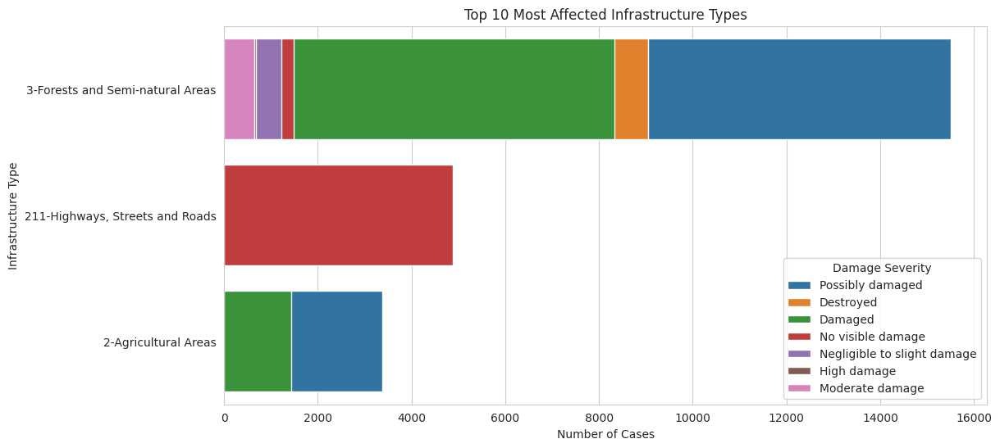

<ipython-input-21-04bf738327db>:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=most_affected, x="count", y="obj_type", ax=axes[0], palette="Reds_r")
<ipython-input-21-04bf738327db>:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=least_affected, x="count", y="obj_type", ax=axes[1], palette="Blues_r")


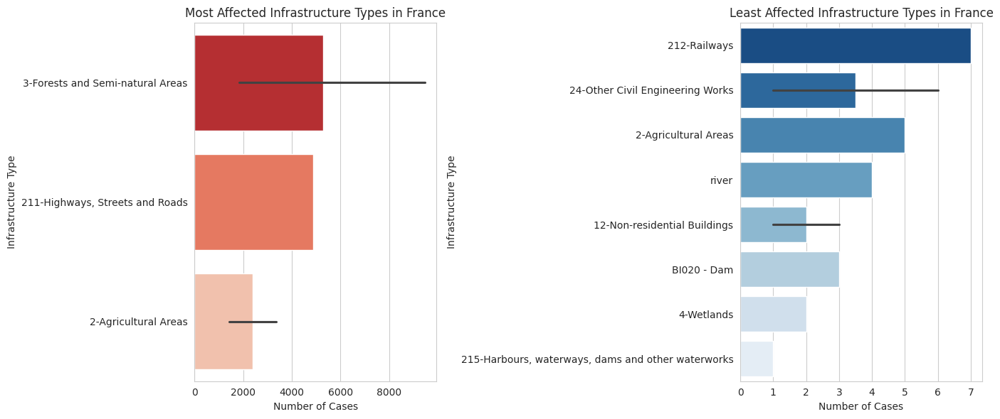

<ipython-input-21-04bf738327db>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=damage_severity_counts, x="Damage Severity", y="Count", palette="viridis")


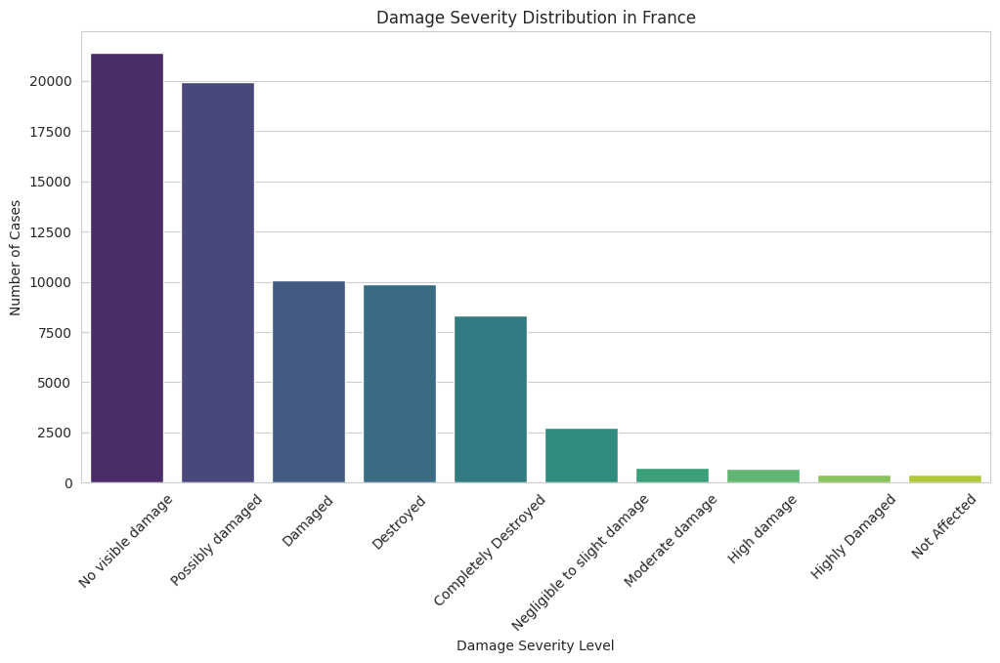

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set plot style
sns.set_style("whitegrid")

# -------------------- 2.1: Infrastructure Damage Count --------------------
plt.figure(figsize=(12, 6))
top_infra = infra_damage_summary_sorted.head(10)  # Top 10 affected infrastructures

sns.barplot(data=top_infra, x="count", y="obj_type", hue="damage_gra", dodge=False)
plt.title("Top 10 Most Affected Infrastructure Types")
plt.xlabel("Number of Cases")
plt.ylabel("Infrastructure Type")
plt.legend(title="Damage Severity")
plt.show()

# -------------------- 2.2: Most vs Least Affected Infrastructure --------------------
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Most Affected
sns.barplot(data=most_affected, x="count", y="obj_type", ax=axes[0], palette="Reds_r")
axes[0].set_title("Most Affected Infrastructure Types in France")
axes[0].set_xlabel("Number of Cases")
axes[0].set_ylabel("Infrastructure Type")

# Least Affected
sns.barplot(data=least_affected, x="count", y="obj_type", ax=axes[1], palette="Blues_r")
axes[1].set_title("Least Affected Infrastructure Types in France")
axes[1].set_xlabel("Number of Cases")
axes[1].set_ylabel("Infrastructure Type")

plt.tight_layout()
plt.show()

# -------------------- 2.3: Damage Severity Distribution --------------------
plt.figure(figsize=(12, 6))
sns.barplot(data=damage_severity_counts, x="Damage Severity", y="Count", palette="viridis")

plt.title("Damage Severity Distribution in France")
plt.xlabel("Damage Severity Level")
plt.ylabel("Number of Cases")
plt.xticks(rotation=45)
plt.show()


In [22]:
# Summarize the impact by disaster type and severity
# Create a new column for disaster classification
df["disaster_type"] = "Unknown"

# Wildfires: High Fire Weather Index (FWI)
df.loc[df["fwi"] > 30, "disaster_type"] = "Wildfire"

# Floods: Infrastructure related to water bodies
flood_keywords = ["Harbours", "Waterways", "Dams", "Canals", "Rivers", "Bridges"]
df.loc[df["obj_type"].astype(str).str.contains("|".join(flood_keywords), case=False, na=False), "disaster_type"] = "Flood"

# Storms: Infrastructure related to energy and telecom
storm_keywords = ["Electrical Grids", "Power Lines", "Telecommunications", "Energy", "Wind Turbines"]
df.loc[df["obj_type"].astype(str).str.contains("|".join(storm_keywords), case=False, na=False), "disaster_type"] = "Storm"

# Display summary of classified disasters
df["disaster_type"].value_counts()

disaster_summary = df.groupby(["disaster_type", "damage_gra"]).size().reset_index(name="count")

# Display the summary using Pandas
# print("📌 Disaster Impact Summary:")
# display(disaster_summary)


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128680 (\N{POLICE CARS REVOLVING LIGHT}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


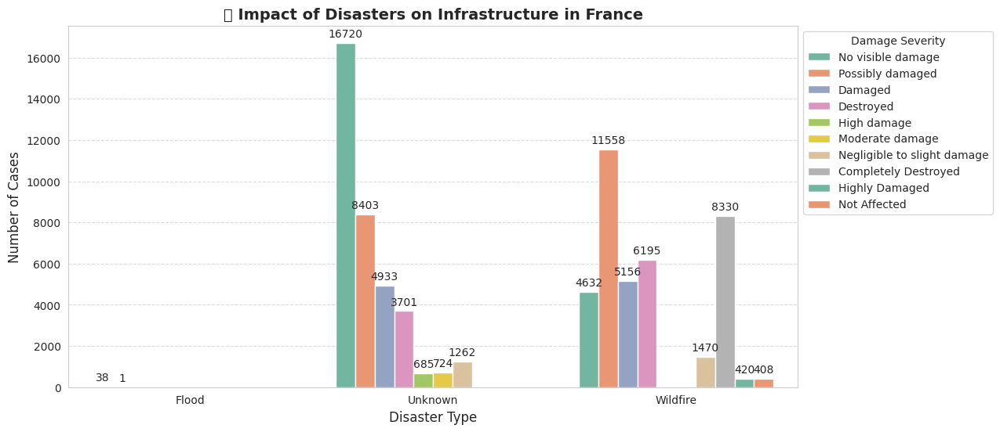

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set Seaborn style
sns.set_style("whitegrid")

# -------------------- Improved Disaster Type vs Damage Severity --------------------
plt.figure(figsize=(12, 6))

# Use grouped bar chart for better comparison
sns.barplot(data=disaster_summary, x="disaster_type", y="count", hue="damage_gra", palette="Set2")

# Add better labels and annotations
plt.title("🚨 Impact of Disasters on Infrastructure in France", fontsize=14, fontweight="bold")
plt.xlabel("Disaster Type", fontsize=12)
plt.ylabel("Number of Cases", fontsize=12)
plt.xticks(rotation=0)
plt.legend(title="Damage Severity", bbox_to_anchor=(1, 1), loc="upper left")
plt.grid(axis="y", linestyle="--", alpha=0.7)

# Annotate key values
for container in plt.gca().containers:
    plt.gca().bar_label(container, fmt='%d', label_type="edge", fontsize=10, padding=3)

plt.show()

# -------------------- Improved Time-Series Trends of Disasters --------------------
plt.figure(figsize=(12, 6))



# Flood Impact Analysis - Northern France

## Overview
This map visualizes the **flood impact in Northern France**, particularly in the **Pas-de-Calais region, including Calais, Saint-Omer, Lille, and surrounding areas**. The map highlights **flooded zones** and **water depth levels**, providing critical insights for disaster assessment.

## Key Elements in the Map
- **🔴 Flooded Areas (Red):** Zones that experienced severe flooding.
- **🔵 Water Depth Levels (Blue):** Indicate the extent and depth of floodwater accumulation.

## Business Usefulness for the Company
- **📊 Risk Assessment:** Helps **infrastructure and insurance companies** evaluate flood damage.  
- **🌍 Environmental Impact:** Identifies affected urban and natural areas for recovery planning.  
- **🛠️ Emergency Response & Mitigation:** Supports **flood risk management and future preparedness**.  
- **📈 Financial & Insurance Modeling:** Aids in **damage estimation, claims processing, and policy adjustments**.  

This analysis supports **flood response strategies, infrastructure resilience, and financial risk management**, ensuring effective decision-making for impacted areas.


In [24]:
import os
import geopandas as gpd
import folium
from folium.plugins import Fullscreen
from IPython.display import display

# Define the folder containing the .shp files
folder_path = "/content/drive/MyDrive/BusinessC2/Data/France/France Flood/France Flood/EMSR706_AOI01_DEL_PRODUCT_v4"  # Update this path

# List of relevant shapefiles for flood analysis
shapefiles = {
    "Flooded Areas": "EMSR706_AOI01_DEL_PRODUCT_observedEventA_v4.shp",
    "Water Depth": "EMSR706_AOI01_DEL_PRODUCT_waterDepthA_v4.shp",
    # "Water Extent": "EMSR706_AOI01_DEL_PRODUCT_waterExtentA_v4.shp"
}

# Define colors for different flood-related layers
layer_colors = {
    "Flooded Areas": "red",
    "Water Depth": "blue",
    # "Water Extent": "red"
}

# Initialize an interactive Folium map centered in France
base_map = folium.Map(location=[50.6, 2.3], zoom_start=10)

# Load and add each flood-related shapefile to the map
for layer_name, shp_file in shapefiles.items():
    shp_path = os.path.join(folder_path, shp_file)

    try:
        # Load the shapefile into a GeoDataFrame
        gdf = gpd.read_file(shp_path)

        # Extract color based on the layer
        color = layer_colors.get(layer_name, "gray")

        # Convert GeoDataFrame to JSON and add to the map
        folium.GeoJson(
            gdf,
            name=layer_name,
            style_function=lambda feature, color=color: {
                "color": color,
                "weight": 2,
                "fillOpacity": 0.5,
            },
            tooltip=folium.GeoJsonTooltip(
                fields=[col for col in gdf.columns if col not in ['geometry']][:3],  # Show first 3 columns
                aliases=[col for col in gdf.columns if col not in ['geometry']][:3]
            )
        ).add_to(base_map)

    except Exception as e:
        print(f"Error loading {shp_file}: {e}")

# Extract Total Flooded Area
flooded_area_file = shapefiles["Flooded Areas"]
flooded_area_path = os.path.join(folder_path, flooded_area_file)

try:
    flood_gdf = gpd.read_file(flooded_area_path)
    total_flooded_area = flood_gdf["area"].sum()  # Sum of flooded areas
    flooded_area_text = f"Total Flooded Area: {total_flooded_area:.2f} sq. km"
except Exception as e:
    print(f"Error extracting flooded area: {e}")
    flooded_area_text = "Flooded Area Data Not Available"

# Add a legend manually using an HTML overlay
legend_html = f"""
<div style="position: fixed;
            bottom: 40px; left: 40px; width: 250px; height: auto;
            background-color: white; z-index:9999; font-size:14px;
            border-radius:5px; padding: 10px;
            box-shadow: 2px 2px 5px rgba(0,0,0,0.3);">
    <b>Legend</b><br>
    <i class="fa fa-map-marker fa-2x" style="color:{layer_colors['Flooded Areas']}"></i> Flooded Areas<br>
    <i class="fa fa-map-marker fa-2x" style="color:{layer_colors['Water Depth']}"></i> Water Depth Levels<br>
    <hr>
    <b>{flooded_area_text}</b>
</div>
"""

base_map.get_root().html.add_child(folium.Element(legend_html))

# Add full-screen support
Fullscreen(position="topright").add_to(base_map)

# Add a layer control to toggle different layers
folium.LayerControl().add_to(base_map)

# Display the interactive map inside Jupyter Notebook
display(base_map)


In [25]:
# Define cost multipliers based on damage severity
cost_multipliers = {
    "No visible damage": 0,
    "Possibly damaged": 10_000,
    "Damaged": 50_000,
    "Destroyed": 150_000,
    "Completely Destroyed": 500_000,
    "High damage": 200_000,
    "Moderate damage": 100_000,
    "Negligible to slight damage": 5_000,
    "Highly Damaged": 300_000
}

# Apply cost multipliers
df["estimated_cost"] = df["damage_gra"].map(cost_multipliers) * df["disaster_type"].notnull()

# Summarize total estimated losses per disaster type
cost_summary = df.groupby("disaster_type")["estimated_cost"].sum().reset_index()

# Display results
import pandas as pd
pd.options.display.float_format = '€{:,.2f}'.format  # Format as currency
display(cost_summary)


,disaster_type,estimated_cost
0,Flood,"€10,000.00"
1,Unknown,"€1,101,540,000.00"
2,Wildfire,"€5,600,980,000.00"


In [26]:
# Summarize total estimated cost per infrastructure type
infra_cost_summary = df.groupby("obj_type")["estimated_cost"].sum().reset_index()

# Sort by highest financial loss
infra_cost_summary = infra_cost_summary.sort_values(by="estimated_cost", ascending=False)

# Display results
display(infra_cost_summary.head(10))  # Show top 10 highest-cost infrastructures


,obj_type,estimated_cost
10,3-Forests and Semi-natural Areas,"€2,134,800,000.00"
2,2-Agricultural Areas,"€200,570,000.00"
0,11-Residential Buildings,"€22,890,000.00"
3,"211-Highways, Streets and Roads","€2,320,000.00"
1,12-Non-residential Buildings,"€890,000.00"
7,"22-Pipelines, Communication and Electricity Lines","€240,000.00"
9,24-Other Civil Engineering Works,"€110,000.00"
6,"215-Harbours, waterways, dams and other waterw...","€10,000.00"
4,212-Railways,€0.00
5,213-Airfield,€0.00


<ipython-input-27-eaa87d0f4017>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=cost_summary, x="disaster_type", y="estimated_cost", palette="coolwarm")
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128176 (\N{MONEY BAG}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


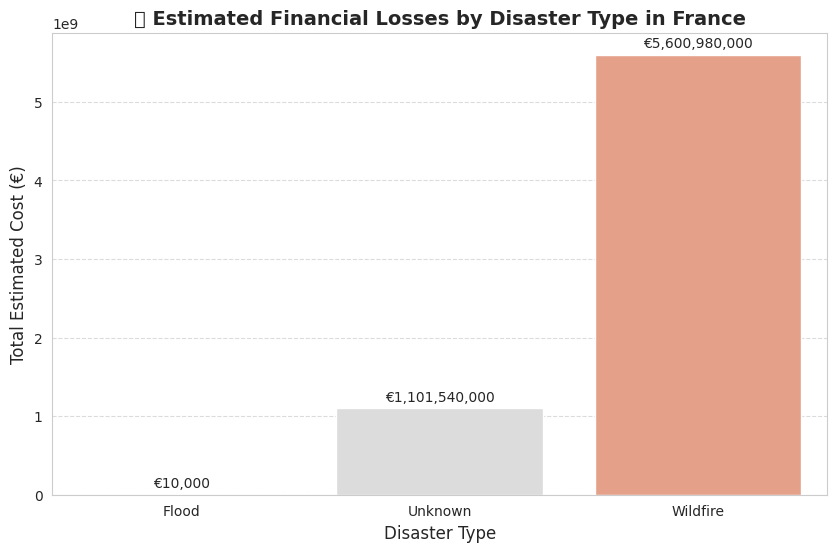

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127959 (\N{BUILDING CONSTRUCTION}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


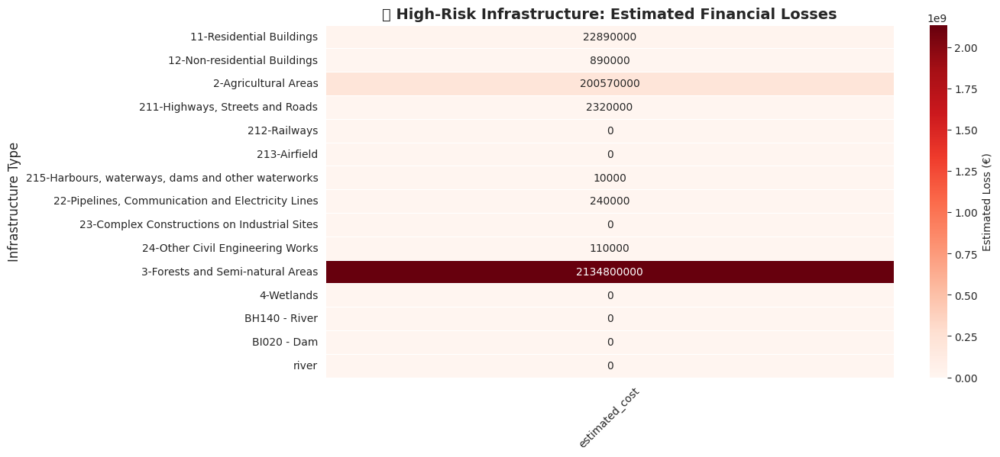

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set Seaborn style
sns.set_style("whitegrid")

# -------------------- 💰 Financial Losses by Disaster Type --------------------
plt.figure(figsize=(10, 6))
sns.barplot(data=cost_summary, x="disaster_type", y="estimated_cost", palette="coolwarm")

plt.title("💰 Estimated Financial Losses by Disaster Type in France", fontsize=14, fontweight="bold")
plt.xlabel("Disaster Type", fontsize=12)
plt.ylabel("Total Estimated Cost (€)", fontsize=12)
plt.xticks(rotation=0)
plt.grid(axis="y", linestyle="--", alpha=0.7)

# Annotate cost values
for container in plt.gca().containers:
    plt.gca().bar_label(container, fmt='€{:,.0f}', label_type="edge", fontsize=10, padding=3)

plt.show()

# -------------------- 🏗️ High-Risk Infrastructure Heatmap --------------------
plt.figure(figsize=(12, 6))
infra_heatmap = infra_cost_summary.pivot_table(index="obj_type", values="estimated_cost")

sns.heatmap(infra_heatmap, cmap="Reds", linewidths=0.5, annot=True, fmt=".0f", cbar_kws={'label': "Estimated Loss (€)"})

plt.title("🏗️ High-Risk Infrastructure: Estimated Financial Losses", fontsize=14, fontweight="bold")
plt.xlabel("")
plt.ylabel("Infrastructure Type", fontsize=12)
plt.xticks(rotation=45)
plt.show()
